<a href="https://colab.research.google.com/github/Rohini-guvi/Project4-Customer-Conversion-Analysis-for-Online-Shopping-Using-Clickstream-Data/blob/main/model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,MinMaxScaler,LabelEncoder
from sklearn.model_selection import train_test_split,GridSearchCV,RandomizedSearchCV
from sklearn.linear_model import LinearRegression,Ridge,Lasso,LogisticRegression
from sklearn.tree import DecisionTreeRegressor,DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier,KNeighborsRegressor
from sklearn.cluster import KMeans,AgglomerativeClustering,DBSCAN
from scipy.cluster.hierarchy import dendrogram,linkage

from xgboost import XGBRegressor,XGBClassifier

from sklearn.metrics import mean_squared_error, r2_score, root_mean_squared_error,mean_absolute_error
from sklearn.metrics import accuracy_score,precision_score,recall_score,f1_score,confusion_matrix,classification_report,roc_curve,roc_auc_score
from sklearn.metrics import silhouette_score,davies_bouldin_score

import warnings
warnings.filterwarnings('ignore')

import pickle

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/train_data.csv",delimiter=',')

In [ ]:
data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,6,22,21,29,15648,3,C20,13,1,2,48,1,2
1,2008,5,19,6,29,10018,2,B26,13,3,1,57,1,2
2,2008,7,15,2,29,19388,3,C13,9,5,1,48,1,1
3,2008,5,2,2,29,7181,2,B11,2,4,1,43,2,1
4,2008,6,9,16,29,13493,2,B31,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,2008,7,4,3,29,17622,4,P19,2,1,1,48,1,2
132375,2008,6,19,9,29,15165,3,C26,14,3,1,28,2,2
132376,2008,7,15,4,29,19359,1,A4,3,2,2,38,2,1
132377,2008,7,28,16,29,21454,3,C50,9,5,2,20,2,3


In [ ]:
data.shape

(132379, 14)

In [ ]:
data.describe()

,year,month,day,order,country,session_id,page1_main_category,colour,location,model_photography,price,price_2,page
count,132379.0,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000,132379.000000
mean,2008.0,5.582759,14.507671,9.811314,26.949629,12038.722063,2.400426,6.227393,3.261106,1.260026,43.788191,1.488484,1.712137
std,0.0,1.328064,8.829106,13.458937,7.153071,7012.460866,1.145004,4.238354,1.714058,0.438650,12.539390,0.499869,0.983699
min,2008.0,4.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,18.000000,1.000000,1.000000
25%,2008.0,4.000000,7.000000,2.000000,29.000000,5905.000000,1.000000,3.000000,2.000000,1.000000,33.000000,1.000000,1.000000
50%,2008.0,5.000000,14.000000,6.000000,29.000000,11931.000000,2.000000,4.000000,3.000000,1.000000,43.000000,1.000000,1.000000
75%,2008.0,7.000000,22.000000,12.000000,29.000000,18212.000000,3.000000,9.000000,5.000000,2.000000,52.000000,2.000000,2.000000
max,2008.0,8.000000,31.000000,195.000000,47.000000,24026.000000,4.000000,14.000000,6.000000,2.000000,82.000000,2.000000,5.000000


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 132379 entries, 0 to 132378
Data columns (total 14 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   year                  132379 non-null  int64 
 1   month                 132379 non-null  int64 
 2   day                   132379 non-null  int64 
 3   order                 132379 non-null  int64 
 4   country               132379 non-null  int64 
 5   session_id            132379 non-null  int64 
 6   page1_main_category   132379 non-null  int64 
 7   page2_clothing_model  132379 non-null  object
 8   colour                132379 non-null  int64 
 9   location              132379 non-null  int64 
 10  model_photography     132379 non-null  int64 
 11  price                 132379 non-null  int64 
 12  price_2               132379 non-null  int64 
 13  page                  132379 non-null  int64 
dtypes: int64(13), object(1)
memory usage: 14.1+ MB


In [ ]:
data.isnull().sum()

,0
year,0
month,0
day,0
order,0
country,0
session_id,0
page1_main_category,0
page2_clothing_model,0
colour,0
location,0


In [ ]:
data['month'].value_counts()

,count
month,
4,38664
5,28572
7,28032
6,25794
8,11317


In [ ]:
month_map = {4:'April',5:'May',6:'June',7:'July',8:'August'}
data['month'] = data['month'].map(month_map)

In [ ]:
data['month'].value_counts()

,count
month,
April,38664
May,28572
July,28032
June,25794
August,11317


In [ ]:
data['page'].value_counts()

,count
page,
1,74637
2,32882
3,15470
4,7110
5,2280


In [ ]:
data['order'].value_counts()

,count
order,
1,19281
2,15230
3,12446
4,10406
5,8733
...,...
185,1
174,1
195,1


In [ ]:
data['price_2'].value_counts()

,count
price_2,
1,67714
2,64665


In [ ]:
data.dtypes

,0
year,int64
month,object
day,int64
order,int64
country,int64
session_id,int64
page1_main_category,int64
page2_clothing_model,object
colour,int64
location,int64


In [ ]:
map_country = {
    1: "Australia",
    2: "Austria",
    3: "Belgium",
    4: "British Virgin Islands",
    5: "Cayman Islands",
    6: "Christmas Island",
    7: "Croatia",
    8: "Cyprus",
    9: "Czech Republic",
    10: "Denmark",
    11: "Estonia",
    12: "unidentified",
    13: "Faroe Islands",
    14: "Finland",
    15: "France",
    16: "Germany",
    17: "Greece",
    18: "Hungary",
    19: "Iceland",
    20: "India",
    21: "Ireland",
    22: "Italy",
    23: "Latvia",
    24: "Lithuania",
    25: "Luxembourg",
    26: "Mexico",
    27: "Netherlands",
    28: "Norway",
    29: "Poland",
    30: "Portugal",
    31: "Romania",
    32: "Russia",
    33 :"San Marion",
    34 :"Slovakia",
    35: "Slovenia",
    36: "Spain",
    37: "Sweden",
    38: "Switzerland",
    39: "Ukraine",
    40: "United Arab Emirates",
    41: "United Kingdom",
    42: "USA",
    43: "biz (.biz)",
    44: "com (.com)",
    45: "int (.int)",
    46: "net (.net)",
    47: "org (*.org)"
}
data['country'] = data['country'].map(map_country)

In [ ]:
data['country'].value_counts()

,count
country,
Poland,107173
Czech Republic,14465
Lithuania,3272
net (.net),1988
com (.com),1130
Germany,632
Ireland,622
Slovakia,584
United Kingdom,539


In [ ]:
map_maincat= {1:'trousers',2:'skirts',3:'blouses',4:'sale'}
data['page1_main_category'] = data['page1_main_category'].map(map_maincat)

In [ ]:
data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,June,22,21,Poland,15648,blouses,C20,13,1,2,48,1,2
1,2008,May,19,6,Poland,10018,skirts,B26,13,3,1,57,1,2
2,2008,July,15,2,Poland,19388,blouses,C13,9,5,1,48,1,1
3,2008,May,2,2,Poland,7181,skirts,B11,2,4,1,43,2,1
4,2008,June,9,16,Poland,13493,skirts,B31,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,2008,July,4,3,Poland,17622,sale,P19,2,1,1,48,1,2
132375,2008,June,19,9,Poland,15165,blouses,C26,14,3,1,28,2,2
132376,2008,July,15,4,Poland,19359,trousers,A4,3,2,2,38,2,1
132377,2008,July,28,16,Poland,21454,blouses,C50,9,5,2,20,2,3


In [ ]:
map_color = {
    1:'beige',
    2:'black',
    3:'blue',
    4:'brown',
    5:'burgundy',
    6:'gray',
    7:'green',
    8:'navy blue',
    9:'many colors',
    10:'olive',
    11:'pink',
    12:'red',
    13:'violet',
    14:'white'
}
data['colour'] = data['colour'].map(map_color)

In [ ]:
map_location= {
    1:"top left",
    2:'top in the middle',
    3:'top right',
    4:'bottom left',
    5:'bottom in the middle',
    6:'bottom right'

}
data['location'] = data['location'].map(map_location)

In [ ]:
map_photo = {1:'en face',2:'profile'}
data['model_photography'] = data['model_photography'].map(map_photo)

In [ ]:
map_price2 = {1:'yes',2:'no'}
data['price_2'] = data['price_2'].map(map_price2)

In [ ]:
data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,June,22,21,Poland,15648,blouses,C20,violet,top left,profile,48,yes,2
1,2008,May,19,6,Poland,10018,skirts,B26,violet,top right,en face,57,yes,2
2,2008,July,15,2,Poland,19388,blouses,C13,many colors,bottom in the middle,en face,48,yes,1
3,2008,May,2,2,Poland,7181,skirts,B11,black,bottom left,en face,43,no,1
4,2008,June,9,16,Poland,13493,skirts,B31,many colors,bottom in the middle,en face,57,yes,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,2008,July,4,3,Poland,17622,sale,P19,black,top left,en face,48,yes,2
132375,2008,June,19,9,Poland,15165,blouses,C26,white,top right,en face,28,no,2
132376,2008,July,15,4,Poland,19359,trousers,A4,blue,top in the middle,profile,38,no,1
132377,2008,July,28,16,Poland,21454,blouses,C50,many colors,bottom in the middle,profile,20,no,3


# **EDA**

In [ ]:
# Orders made across months
df = data.groupby(['month'])[['order','price']].agg(
    total_order = ('order','sum'),
    total_price = ('price','sum')
    ).reset_index()
df

,month,total_order,total_price
0,April,367595,1685312
1,August,130063,500129
2,July,276153,1231229
3,June,243358,1128808
4,May,281643,1251159


Text(0.5, 1.0, 'Total Sales across months')

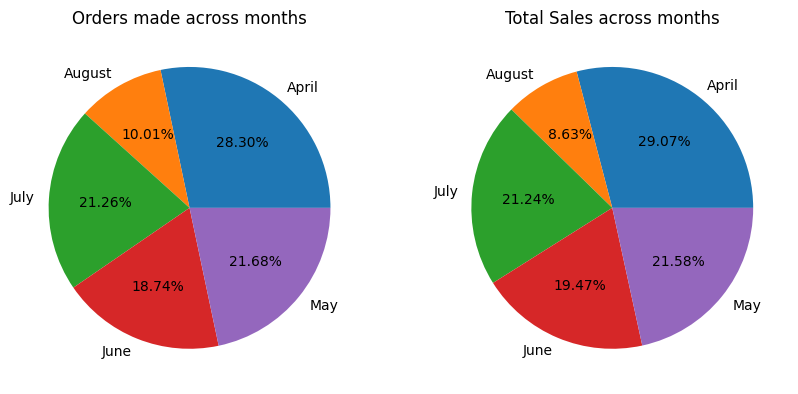

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].pie(data=df,x='total_order',labels=df['month'],autopct="%.2f%%")
ax[0].set_title('Orders made across months')

ax[1].pie(data=df,x='total_price',labels=df['month'],autopct='%.2f%%')
ax[1].set_title('Total Sales across months')

In [ ]:
df=data.groupby(['month','day'])[['order','price']].agg(
    total_order = ('order','sum'),
    total_price = ('price','sum')
    ).reset_index()
df

,month,day,total_order,total_price
0,April,1,19857,111568
1,April,2,25227,121427
2,April,3,13009,65774
3,April,4,13726,63863
4,April,5,10898,54010
...,...,...,...,...
130,May,27,9482,42607
131,May,28,9433,45689
132,May,29,13484,53373
133,May,30,3568,29904


In [ ]:
px.bar(df,x='day',y='total_order',color='month',barmode='group',title='Days of the month vs Orders')

In [ ]:
px.bar(df,x='day',y='total_price',color='month',barmode='group',title='Days of the month vs Sales')

In [ ]:
data.groupby(['country'])['price'].agg(sum).sort_values(ascending=False)

,price
country,
Poland,4656723
Czech Republic,663619
Lithuania,143464
net (.net),89901
com (.com),50099
Germany,28267
Slovakia,27016
Ireland,26733
United Kingdom,23632


<Axes: title={'center': 'Top 10 countries with high Online Purchases'}, xlabel='country'>

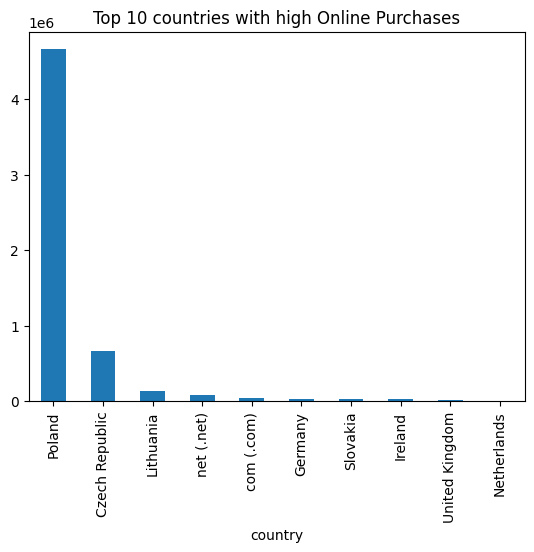

In [ ]:
plt.title("Top 10 countries with high Online Purchases")
data.groupby(['country'])['price'].agg(sum).sort_values(ascending=False).head(10).plot(kind='bar')

In [ ]:
df = data.groupby(['country','month'])['price'].agg('mean').reset_index()
px.bar(df,x='country',y='price',color='month',barmode='group',title='Trend on average of online purchases across country over months')

In [ ]:
data.groupby(['session_id'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).reset_index().sort_values(by='total_price',ascending=False)

,session_id,order_count,total_price
13177,13846,164,7265
21384,22433,157,6675
21828,22902,136,5629
7793,8201,129,5100
18694,19623,113,4998
...,...,...,...
13534,14211,1,20
2037,2131,1,20
10260,10792,1,20
288,303,1,18


In [ ]:
df=data.groupby(['page1_main_category'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).sort_values(by='total_price',ascending=False).reset_index()
df

,page1_main_category,order_count,total_price
0,trousers,39891,1862645
1,skirts,30583,1565140
2,blouses,30911,1245530
3,sale,30994,1123322


Text(0.5, 1.0, 'Category wise sales')

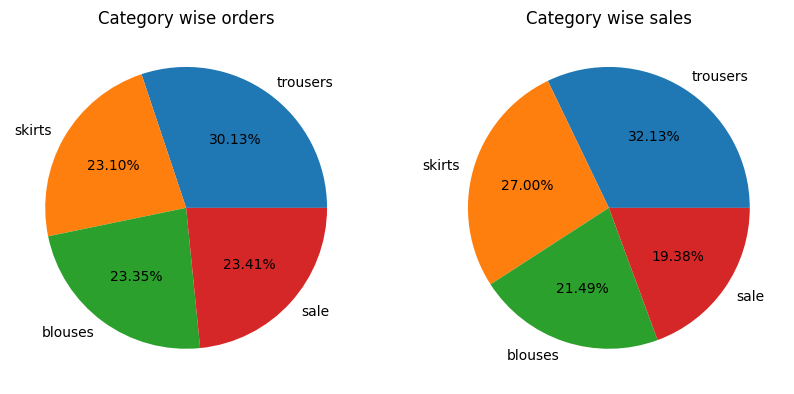

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(10,5))
ax[0].pie(data=df,x='order_count',labels=df['page1_main_category'],autopct="%.2f%%")
ax[0].set_title('Category wise orders')

ax[1].pie(data=df,x='total_price',labels=df['page1_main_category'],autopct='%.2f%%')
ax[1].set_title('Category wise sales')

In [ ]:
df=data.groupby(['page2_clothing_model'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).sort_values(by='total_price',ascending=False).reset_index()
df

,page2_clothing_model,order_count,total_price
0,B4,2824,146848
1,A11,2247,139314
2,B10,2011,134737
3,A9,1542,126444
4,A3,1524,109728
...,...,...,...
211,P31,64,2112
212,P66,42,1806
213,P22,2,104
214,P79,2,104


<Axes: title={'center': 'Top 10 clothing models with high Online Purchases'}, xlabel='page2_clothing_model', ylabel='total_price'>

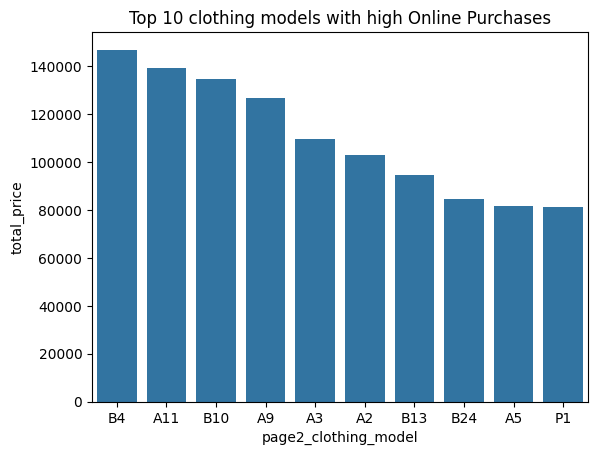

In [ ]:
plt.title("Top 10 clothing models with high Online Purchases")
sns.barplot(df.head(10),x='page2_clothing_model',y='total_price')

In [ ]:
data.groupby(['location','page',])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).sort_values(by='total_price',ascending=False).reset_index()

,location,page,order_count,total_price
0,top left,1,15061,663155
1,top in the middle,1,14608,640187
2,bottom left,1,13643,636470
3,bottom in the middle,1,11942,497728
4,top right,1,9353,478085
5,bottom right,1,10030,423549
6,bottom in the middle,2,6806,311379
7,top left,2,6045,288072
8,top in the middle,2,5598,256831
9,top right,2,5217,237853


In [ ]:
data.groupby(['colour'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).reset_index()

,colour,order_count,total_price
0,beige,6266,249593
1,black,23840,1119549
2,blue,23380,1151674
3,brown,13186,528597
4,burgundy,1346,51657
5,gray,13966,566873
6,green,5474,191567
7,many colors,10865,440777
8,navy blue,2146,64768
9,olive,2824,146848


<Axes: title={'center': 'Sales based on colours'}, xlabel='colour'>

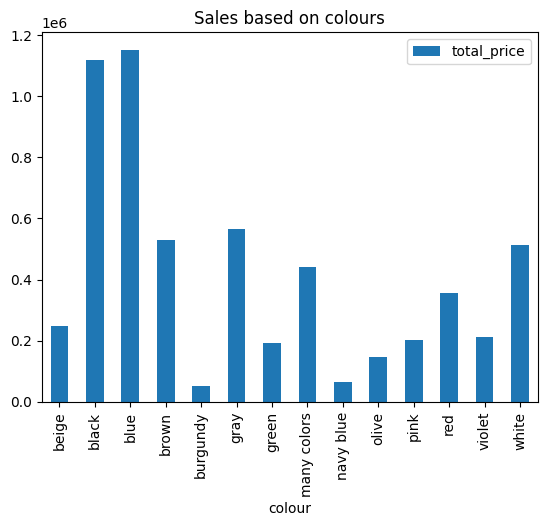

In [ ]:
data.groupby(['colour'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).reset_index().plot(kind='bar',x='colour',y='total_price',title='Sales based on colours')

In [ ]:
data.groupby(['page1_main_category','model_photography'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).reset_index()

,page1_main_category,model_photography,order_count,total_price
0,blouses,en face,21599,908520
1,blouses,profile,9312,337010
2,sale,en face,17978,647685
3,sale,profile,13016,475637
4,skirts,en face,25750,1316564
5,skirts,profile,4833,248576
6,trousers,en face,32630,1572626
7,trousers,profile,7261,290019


In [ ]:
df = data.groupby(['page1_main_category','price_2'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).reset_index()

df

,page1_main_category,price_2,order_count,total_price
0,blouses,no,13279,379732
1,blouses,yes,17632,865798
2,sale,no,14147,420371
3,sale,yes,16847,702951
4,skirts,no,10979,435182
5,skirts,yes,19604,1129958
6,trousers,no,26260,979670
7,trousers,yes,13631,882975


<Axes: title={'center': 'Sales of categories based on product pricing above/below Average Price'}, xlabel='page1_main_category', ylabel='total_price'>

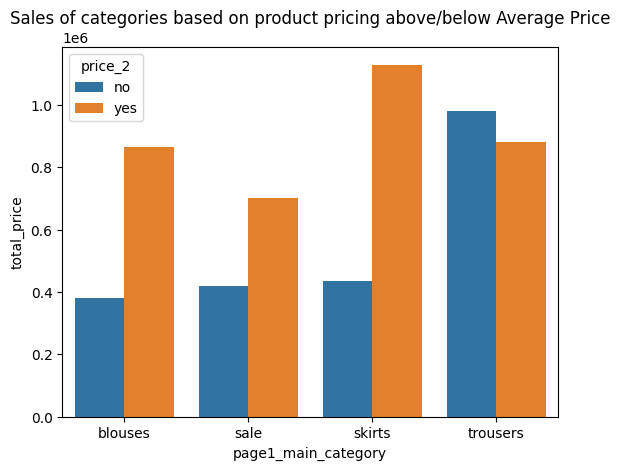

In [ ]:
plt.title("Sales of categories based on product pricing above/below Average Price")
sns.barplot(df,x='page1_main_category',y='total_price',hue='price_2')

In [ ]:
df = data.groupby(['page1_main_category','colour','page2_clothing_model'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).sort_values(by='total_price',ascending=False).head(10).reset_index()

df

,page1_main_category,colour,page2_clothing_model,order_count,total_price
0,skirts,olive,B4,2824,146848
1,trousers,blue,A11,2247,139314
2,skirts,black,B10,2011,134737
3,trousers,blue,A9,1542,126444
4,trousers,blue,A3,1524,109728
5,trousers,blue,A2,2389,102727
6,skirts,red,B13,1524,94488
7,skirts,pink,B24,1485,84645
8,trousers,blue,A5,1898,81614
9,sale,blue,P1,2134,81092


In [ ]:
df = data.groupby(['page1_main_category','page'])[['order','price']].agg(
    order_count = ('order','count'),
    total_price = ('price','sum')
    ).reset_index()
df

,page1_main_category,page,order_count,total_price
0,blouses,1,13469,540957
1,blouses,2,7253,313738
2,blouses,3,7297,251617
3,blouses,4,2892,139218
4,sale,1,14418,522353
5,sale,2,4889,180625
6,sale,3,5189,179412
7,sale,4,4218,146074
8,sale,5,2280,94858
9,skirts,1,18769,973920


<Axes: title={'center': 'Preferences of customers in each page'}, xlabel='page', ylabel='total_price'>

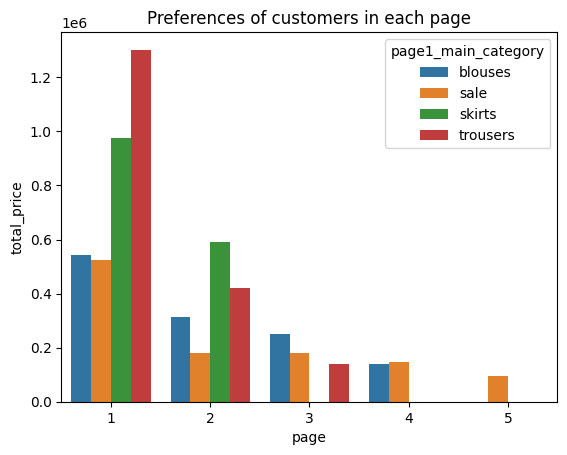

In [ ]:
plt.title("Preferences of customers in each page")
sns.barplot(data=df,x='page',y='total_price',hue='page1_main_category')

<Axes: xlabel='price', ylabel='Density'>

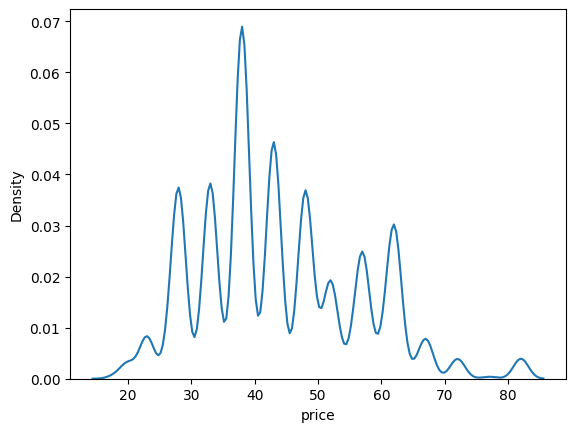

In [ ]:
sns.kdeplot(data['price'])

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/train_data.csv",delimiter=',')

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
 [Text(0, 0, 'year'),
  Text(1, 0, 'month'),
  Text(2, 0, 'day'),
  Text(3, 0, 'order'),
  Text(4, 0, 'country'),
  Text(5, 0, 'session_id'),
  Text(6, 0, 'page1_main_category'),
  Text(7, 0, 'colour'),
  Text(8, 0, 'location'),
  Text(9, 0, 'model_photography'),
  Text(10, 0, 'price'),
  Text(11, 0, 'price_2'),
  Text(12, 0, 'page')])

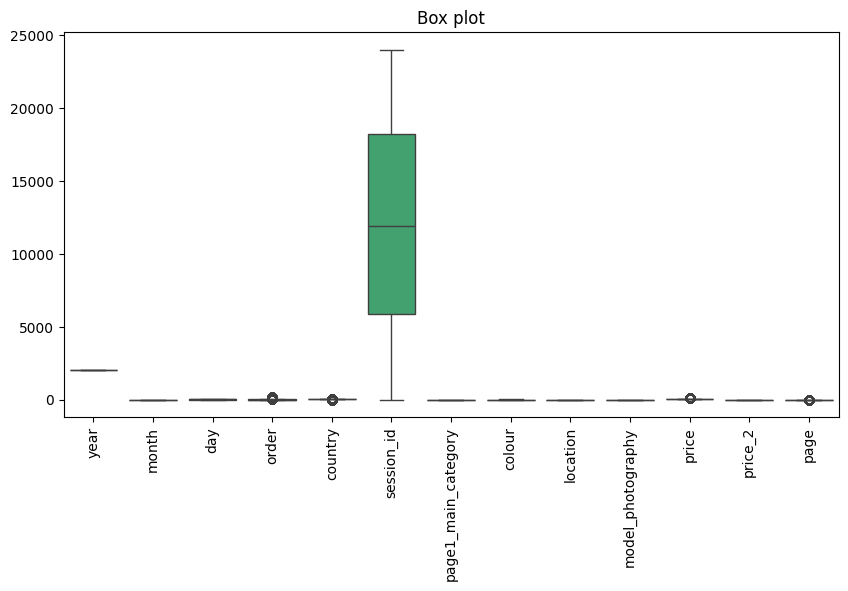

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Box plot")
sns.boxplot(data)
plt.xticks(rotation=90)

<Axes: >

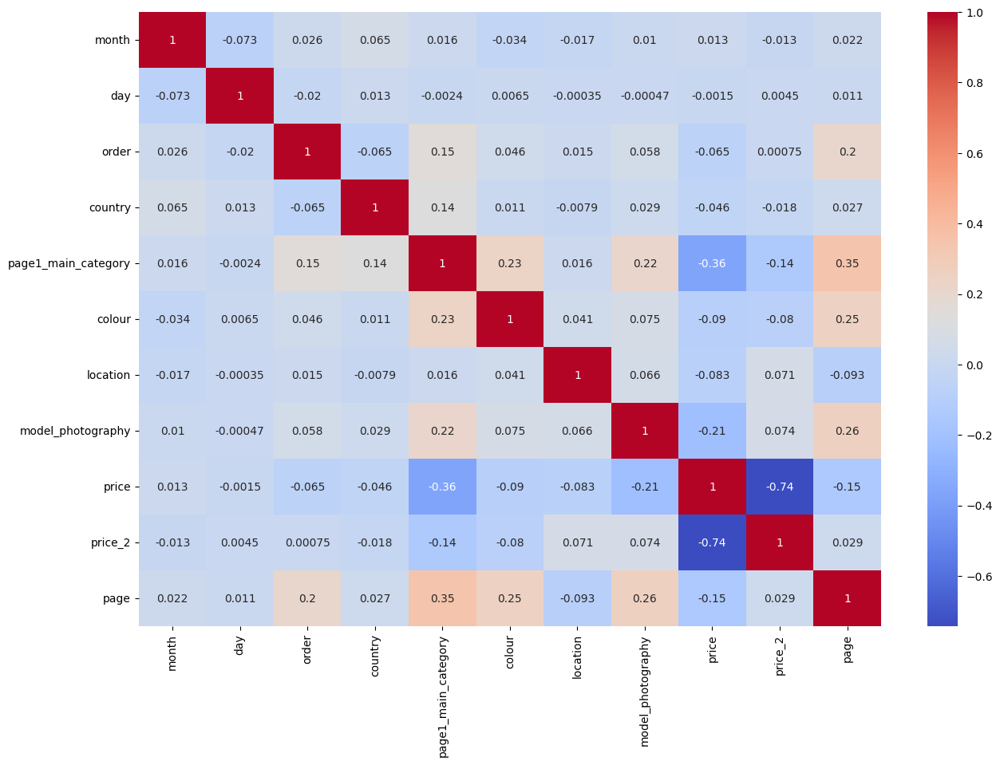

In [ ]:
plt.figure(figsize=(15,10))
num_col = data.select_dtypes(include=np.number).columns.tolist()
num_col.remove('year')
num_col.remove('session_id')
sns.heatmap(data[num_col].corr(),cmap='coolwarm',annot=True)

# **Preprocess**

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/train_data.csv",delimiter=',')

In [ ]:
data['year'].value_counts()

,count
year,
2008,132379


In [ ]:
# Removing Unwanted column
data.drop(columns=['year','session_id'],inplace=True)

In [ ]:
num_col = data.select_dtypes(include=np.number).columns.tolist()
num_col.remove('price')
num_col

['month',
 'day',
 'order',
 'country',
 'page1_main_category',
 'colour',
 'location',
 'model_photography',
 'price_2',
 'page']

In [ ]:
cat_col = data.select_dtypes(include='object').columns.tolist()
cat_col

['page2_clothing_model']

In [ ]:
le = LabelEncoder()
data['page2_clothing_model'] = le.fit_transform(data['page2_clothing_model'])
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,6,22,21,29,3,88,13,1,2,48,1,2
1,5,19,6,29,2,60,13,3,1,57,1,2
2,7,15,2,29,3,80,9,5,1,48,1,1
3,5,2,2,29,2,45,2,4,1,43,2,1
4,6,9,16,29,2,66,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,7,4,3,29,4,145,2,1,1,48,1,2
132375,6,19,9,29,3,94,14,3,1,28,2,2
132376,7,15,4,29,1,33,3,2,2,38,2,1
132377,7,28,16,29,3,121,9,5,2,20,2,3


In [ ]:
preprocess = ColumnTransformer([
    ('scaler',MinMaxScaler(),num_col)
])
preprocess

ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                 ['month', 'day', 'order', 'country',
                                  'page1_main_category', 'colour', 'location',
                                  'model_photography', 'price_2', 'page'])])

# **Regression on Price column**

**Linear Regression**

In [ ]:
data.shape

(132379, 12)

In [ ]:
def reg_performance(act, pred):
  mse = mean_squared_error(act, pred)
  rmse = root_mean_squared_error(act, pred)
  r2score = r2_score(act,pred)
  mae = mean_absolute_error(act,pred)

  return pd.DataFrame({"mse" : [mse],
                       'rmse':[rmse],
                       "r2_score":[r2score],
                       "mae" :[mae]
                       })

In [ ]:
val = data.drop(columns=['price'],axis=1)
tar = data['price']

tr,ts,tr_target,ts_target = train_test_split(val,tar,test_size=0.2,random_state=42)

**Linear Regression**

In [ ]:
lr_model = Pipeline([('preprocess',preprocess),('lr',LinearRegression())])
lr_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('lr', LinearRegression())])

In [ ]:
tr_pred = lr_model.predict(tr)
ts_pred = lr_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,33.929363,5.824892,0.783775,4.379597


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,33.814998,5.815066,0.786666,4.36283


In [ ]:
param_grid = {'copy_X': [True,False], 'fit_intercept': [True,False],
               'n_jobs': [1,5,10,15,None], 'positive': [True,False]}
grid_lr = GridSearchCV(LinearRegression(), param_grid=param_grid, cv = 5, scoring= 'neg_root_mean_squared_error', n_jobs= -1)
lr_grid=Pipeline(steps=[('preprocess', preprocess), ("LRGrid",grid_lr)])

In [ ]:
lr_grid.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('LRGrid',
                 GridSearchCV(cv=5, estimator=LinearRegression(), n_jobs=-1,
                              param_grid={'copy_X': [True, False],
                                          'fit_intercept': [True, False],
                                          'n_jobs': [1, 5, 10, 15, None],
                                          'positive': [True, False]},
                              scoring='neg_root_mean_squared_error'))])

In [ ]:
grid_lr.best_params_

{'copy_X': True, 'fit_intercept': True, 'n_jobs': 1, 'positive': False}

In [ ]:
grid_lr.best_score_

np.float64(-5.825586449396406)

In [ ]:
best_model_lr = grid_lr.best_estimator_
best_model_lr

LinearRegression(n_jobs=1)

In [ ]:
lr_bs_model=Pipeline(steps=[('preprocess', preprocess) ,("LRGrid Best Model",best_model_lr)])
lr_bs_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('LRGrid Best Model', LinearRegression(n_jobs=1))])

In [ ]:
tr_pred = lr_bs_model.predict(tr)
ts_pred = lr_bs_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,33.929363,5.824892,0.783775,4.379597


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,33.814998,5.815066,0.786666,4.36283


**Ridge**

In [ ]:
lrr_model = Pipeline([('preprocess',preprocess),('Ridge',Ridge())])
lrr_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('Ridge', Ridge())])

In [ ]:
tr_pred = lrr_model.predict(tr)
ts_pred = lrr_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,33.929364,5.824892,0.783775,4.379575


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,33.815038,5.81507,0.786666,4.36281


**Lasso**

In [ ]:
lrl_model = Pipeline([('preprocess',preprocess),('Lasso',Lasso())])
lrl_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('Lasso', Lasso())])

In [ ]:
tr_pred=lrl_model.predict(tr)
ts_pred=lrl_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,47.905249,6.921362,0.69471,5.187744


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,48.273924,6.947944,0.695446,5.204262


**KNeighborsRegressor**

In [ ]:
kreg = Pipeline(steps=[('preprocess', preprocess),
 ("KNN Regression", KNeighborsRegressor(n_neighbors=5))])
kreg.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('KNN Regression', KNeighborsRegressor())])

In [ ]:
tr_pred = kreg.predict(tr)
ts_pred = kreg.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,2.98452,1.727576,0.98098,0.351101


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,4.923783,2.21896,0.968937,0.472534


**XGBRegressor**

In [ ]:
xgb_model = Pipeline(steps=[('preprocess', preprocess),
 ("XGB Regression", XGBRegressor(n_estimators= 150, learning_rate= 0.01,max_depth=10, random_state= 52, subsample= 0.9))])

xgb_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('XGB Regression',
                 XGBRegressor(base_score=None, booster=None, callbacks=None,
                              colsample_bylevel=None, colsample_bynode=None,
                              colsample_bytree=None, devic...
                              feature_types=None, gamma=None, grow_policy=None,
                              importance_type=None,
                              interaction_constraints=None, learning_rate=0.01,
                              max_bin=None, max_cat_threshold=None,
                              max_cat_to_onehot=None, max_delta_step=None,
                              max_depth=10, max_leaves=None,
                              min_child_weight=None, missing=nan,
                              monotone_constraints=None, multi_strategy=None,
                              n_estimators=150, n_jobs=None,
                              num_parallel_tree=None, random_state=52, ...))])

In [ ]:
tr_pred = xgb_model.predict(tr)
ts_pred = xgb_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,10.913151,3.303506,0.930453,2.446262


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,11.191543,3.345376,0.929394,2.470571


In [ ]:
param_grid = {
    "n_estimators": [50,100,150],
    "max_depth": [9,10,11,12],
    "learning_rate":[0.001,0.01, 0.1],
    'subsample': [0.8,0.9, 1.0]
}

grid_gb = RandomizedSearchCV(XGBRegressor(), param_distributions=param_grid, n_iter=10, cv = 5, scoring= 'neg_root_mean_squared_error', n_jobs= -1)
xgb_gridpipe=Pipeline(steps=[('preprocess', preprocess),("XGBGrid",grid_gb)])
xgb_gridpipe.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('XGBGrid',
                 RandomizedSearchCV(cv=5,
                                    estimator=XGBRegressor(base_score=None,
                                                           booster=None,
                                                           callbacks=None,
                                                           colsample_bylevel=None,
                                                           colsample_bynode=None...
                                                           max_leaves=None,
                                                           min_child_weight=None,
                                                           missing=nan,
                                                           monotone_constraints=None,
                                                           multi_strategy=None,
                                                           n_estimators=None,
                                                           n_jobs=None,
                                                           num_parallel_tree=None,
                                                           random_state=None, ...),
                                    n_jobs=-1,
                                    param_distributions={'learning_rate': [0.001,
                                                                           0.01,
                                                                           0.1],
                                                         'max_depth': [9, 10,
                                                                       11, 12],
                                                         'n_estimators': [50,
                                                                          100,
                                                                          150],
                                                         'subsample': [0.8, 0.9,
                                                                       1.0]},
                                    scoring='neg_root_mean_squared_error'))])

In [ ]:
grid_gb.best_params_

{'subsample': 0.9, 'n_estimators': 50, 'max_depth': 10, 'learning_rate': 0.1}

In [ ]:
grid_gb.best_score_

np.float64(-1.8808513879776)

In [ ]:
best_model_gb = grid_gb.best_estimator_
best_model_gb

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=10, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=50, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [ ]:
# Validation of model
gb_bs_model=Pipeline(steps=[('preprocess', preprocess),("XGBGrid Best Model",best_model_gb)])
gb_bs_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('XGBGrid Best Model',
                 XGBRegressor(base_score=None, booster=None, callbacks=None,
                              colsample_bylevel=None, colsample_bynode=None,
                              colsample_bytree=None, de...
                              feature_types=None, gamma=None, grow_policy=None,
                              importance_type=None,
                              interaction_constraints=None, learning_rate=0.1,
                              max_bin=None, max_cat_threshold=None,
                              max_cat_to_onehot=None, max_delta_step=None,
                              max_depth=10, max_leaves=None,
                              min_child_weight=None, missing=nan,
                              monotone_constraints=None, multi_strategy=None,
                              n_estimators=50, n_jobs=None,
                              num_parallel_tree=None, random_state=None, ...))])

In [ ]:
tr_pred = gb_bs_model.predict(tr)
ts_pred = gb_bs_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,3.026335,1.739636,0.980714,0.395814


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,3.62539,1.904046,0.977128,0.432953


In [ ]:
import pickle
filename = "/content/drive/MyDrive/Project4-Clickstream/XGB_regbs_model.sav"
pickle.dump(gb_bs_model, open(filename, 'wb'))

**DecisionTree model**

In [ ]:
dt_reg = Pipeline(steps=[('preprocess', preprocess),("DecisionTreeRegressor", DecisionTreeRegressor(random_state= 52))])
dt_reg.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('DecisionTreeRegressor',
                 DecisionTreeRegressor(random_state=52))])

In [ ]:
tr_pred = dt_reg.predict(tr)
ts_pred = dt_reg.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,0.721213,0.849243,0.995404,0.081176


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,6.841187,2.615566,0.95684,0.387929


In [ ]:
param_grid = {
    "max_depth": [2,4,6,8,10,12,14],
    "max_leaf_nodes":[20, 25, 30, 35,40,45,50],
    "min_samples_leaf": [1,2,3,4,5,6,7,8,9,10]
}

grid = GridSearchCV(DecisionTreeRegressor(random_state= 52), param_grid=param_grid, cv = 5, scoring= 'neg_root_mean_squared_error', n_jobs= 2)
dt_gridpipe=Pipeline(steps=[('preprocess', preprocess),("DecisionTreeGrid",grid)])
dt_gridpipe.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('DecisionTreeGrid',
                 GridSearchCV(cv=5,
                              estimator=DecisionTreeRegressor(random_state=52),
                              n_jobs=2,
                              param_grid={'max_depth': [2, 4, 6, 8, 10, 12, 14],
                                          'max_leaf_nodes': [20, 25, 30, 35, 40,
                                                             45, 50],
                                          'min_samples_leaf': [1, 2, 3, 4, 5, 6,
                                                               7, 8, 9, 10]},
                              scoring='neg_root_mean_squared_error'))])

In [ ]:
grid.best_params_

{'max_depth': 8, 'max_leaf_nodes': 50, 'min_samples_leaf': 1}

In [ ]:
grid.best_score_

np.float64(-2.8327164131543934)

In [ ]:
best_model = grid.best_estimator_
best_model

DecisionTreeRegressor(max_depth=8, max_leaf_nodes=50, random_state=52)

In [ ]:
# Validation of model
dt_bs_model=Pipeline(steps=[('preprocess', preprocess), ("DTGrid Best Model",best_model)])
dt_bs_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('DTGrid Best Model',
                 DecisionTreeRegressor(max_depth=8, max_leaf_nodes=50,
                                       random_state=52))])

In [ ]:
tr_pred = dt_bs_model.predict(tr)
ts_pred = dt_bs_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,8.009958,2.830187,0.948954,1.537817


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,8.196488,2.862951,0.948289,1.56345


**RandomForest Regressor**

In [ ]:
rf_reg = Pipeline(steps=[('preprocess', preprocess),
 ("RF Regression", RandomForestRegressor(n_estimators= 150, random_state= 42, max_depth= 3, min_samples_split= 7, min_samples_leaf= 10,n_jobs=-1))])
rf_reg.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('RF Regression',
                 RandomForestRegressor(max_depth=3, min_samples_leaf=10,
                                       min_samples_split=7, n_estimators=150,
                                       n_jobs=-1, random_state=42))])

In [ ]:
tr_pred = rf_reg.predict(tr)
ts_pred = rf_reg.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,23.610993,4.859114,0.849532,3.663325


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,23.625046,4.86056,0.850953,3.658022


In [ ]:
param_grid = {
    "n_estimators": [50, 60,70,80, 90],
    "max_depth": [3,4,5,6,7,8],
    "min_samples_split":[7,8,9,10,11,12,15],
    "min_samples_leaf": [8,9,10,11,12,13,14]
}

grid_rf = RandomizedSearchCV(RandomForestRegressor(), param_distributions=param_grid, n_iter=10,cv = 5, scoring= 'neg_root_mean_squared_error', n_jobs= -1)

rf_gridpipe=Pipeline(steps=[('preprocess', preprocess), ("RFGrid",grid_rf)])
rf_gridpipe.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('RFGrid',
                 RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(),
                                    n_jobs=-1,
                                    param_distributions={'max_depth': [3, 4, 5,
                                                                       6, 7,
                                                                       8],
                                                         'min_samples_leaf': [8,
                                                                              9,
                                                                              10,
                                                                              11,
                                                                              12,
                                                                              13,
                                                                              14],
                                                         'min_samples_split': [7,
                                                                               8,
                                                                               9,
                                                                               10,
                                                                               11,
                                                                               12,
                                                                               15],
                                                         'n_estimators': [50,
                                                                          60,
                                                                          70,
                                                                          80,
                                                                          90]},
                                    scoring='neg_root_mean_squared_error'))])

In [ ]:
grid_rf.best_params_

{'n_estimators': 80,
 'min_samples_split': 12,
 'min_samples_leaf': 10,
 'max_depth': 8}

In [ ]:
grid_rf.best_score_

np.float64(-2.043193019040928)

In [ ]:
best_model_rf = grid_rf.best_estimator_
best_model_rf

RandomForestRegressor(max_depth=8, min_samples_leaf=10, min_samples_split=12,
                      n_estimators=80)

In [ ]:
rf_bs_model=Pipeline(steps=[('preprocess', preprocess), ("RFGrid Best Model",best_model_rf)])
rf_bs_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography',
                                                   'price_2', 'page'])])),
                ('RFGrid Best Model',
                 RandomForestRegressor(max_depth=8, min_samples_leaf=10,
                                       min_samples_split=12,
                                       n_estimators=80))])

In [ ]:
tr_pred = rf_bs_model.predict(tr)
ts_pred = rf_bs_model.predict(ts)
reg_performance(tr_target,tr_pred)

,mse,rmse,r2_score,mae
0,4.164924,2.040815,0.973458,0.663501


In [ ]:
reg_performance(ts_target,ts_pred)

,mse,rmse,r2_score,mae
0,4.378376,2.092457,0.972377,0.688365


Based on r2 score value, XGBRegressor is the best model chosen

In [ ]:
test_data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/test_data.csv",delimiter=',')
test_data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,4,22,4,29,5279,4,P48,9,4,2,33,2,3
1,2008,5,19,1,29,10059,1,A15,14,5,2,33,2,1
2,2008,4,11,10,29,2919,4,P23,6,2,2,28,2,2
3,2008,4,28,3,27,6304,2,B24,11,2,1,57,1,2
4,2008,5,26,1,29,11266,1,A2,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,2008,5,13,1,29,8885,1,A5,3,2,1,43,2,1
33091,2008,4,14,3,29,3546,1,A15,14,5,2,33,2,1
33092,2008,6,13,37,29,14336,2,B9,1,3,1,48,2,1
33093,2008,5,23,16,29,10786,3,C34,7,6,1,48,1,2


In [ ]:
test_data.drop(columns=['year','session_id'],inplace=True)

In [ ]:
test_data['page2_clothing_model'] = le.fit_transform(test_data['page2_clothing_model'])
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,4,22,4,29,4,176,9,4,2,33,2,3
1,5,19,1,29,1,6,14,5,2,33,2,1
2,4,11,10,29,4,149,6,2,2,28,2,2
3,4,28,3,27,2,58,11,2,1,57,1,2
4,5,26,1,29,1,11,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
33090,5,13,1,29,1,38,3,2,1,43,2,1
33091,4,14,3,29,1,6,14,5,2,33,2,1
33092,6,13,37,29,2,75,1,3,1,48,2,1
33093,5,23,16,29,3,103,7,6,1,48,1,2


In [ ]:
val = test_data.drop(columns=['price'],axis=1)
tar = test_data['price']

ts_pred = gb_bs_model.predict(val)
reg_performance(tar,ts_pred)

,mse,rmse,r2_score,mae
0,3.730965,1.931571,0.976435,0.434365


In [ ]:
ts_pred = rf_bs_model.predict(val)
reg_performance(tar,ts_pred)

,mse,rmse,r2_score,mae
0,4.410038,2.100009,0.972146,0.676347


# **Classification on Price 2 column**

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/train_data.csv",delimiter=',')
data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,6,22,21,29,15648,3,C20,13,1,2,48,1,2
1,2008,5,19,6,29,10018,2,B26,13,3,1,57,1,2
2,2008,7,15,2,29,19388,3,C13,9,5,1,48,1,1
3,2008,5,2,2,29,7181,2,B11,2,4,1,43,2,1
4,2008,6,9,16,29,13493,2,B31,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,2008,7,4,3,29,17622,4,P19,2,1,1,48,1,2
132375,2008,6,19,9,29,15165,3,C26,14,3,1,28,2,2
132376,2008,7,15,4,29,19359,1,A4,3,2,2,38,2,1
132377,2008,7,28,16,29,21454,3,C50,9,5,2,20,2,3


In [ ]:
# Removing Unwanted column
data.drop(columns=['year','session_id'],inplace=True)

In [ ]:
data['price_2'].value_counts()

,count
price_2,
1,67714
2,64665


In [ ]:
num_col = data.select_dtypes(include=np.number).columns.tolist()
num_col.remove('price_2')
num_col

['month',
 'day',
 'order',
 'country',
 'page1_main_category',
 'colour',
 'location',
 'model_photography',
 'price',
 'page']

In [ ]:
cat_col = data.select_dtypes(include='object').columns.tolist()
cat_col

['page2_clothing_model']

In [ ]:
le = LabelEncoder()
data['page2_clothing_model'] = le.fit_transform(data['page2_clothing_model'])
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,6,22,21,29,3,88,13,1,2,48,1,2
1,5,19,6,29,2,60,13,3,1,57,1,2
2,7,15,2,29,3,80,9,5,1,48,1,1
3,5,2,2,29,2,45,2,4,1,43,2,1
4,6,9,16,29,2,66,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,7,4,3,29,4,145,2,1,1,48,1,2
132375,6,19,9,29,3,94,14,3,1,28,2,2
132376,7,15,4,29,1,33,3,2,2,38,2,1
132377,7,28,16,29,3,121,9,5,2,20,2,3


In [ ]:
data['price_2']=data['price_2'].map({1:1,2:0})
data['price_2'].value_counts()

,count
price_2,
1,67714
0,64665


In [ ]:
preprocess = ColumnTransformer([
    ('scaler',MinMaxScaler(),num_col)
])
preprocess

ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                 ['month', 'day', 'order', 'country',
                                  'page1_main_category', 'colour', 'location',
                                  'model_photography', 'price', 'page'])])

**Logistic Regression**

In [ ]:
val = data.drop(columns=['price_2'],axis=1)
tar = data['price_2']

tr,ts,tr_target,ts_target = train_test_split(val,tar,test_size=0.2,random_state=57)

In [ ]:
tar

,price_2
0,1
1,1
2,1
3,0
4,1
...,...
132374,1
132375,0
132376,0
132377,0


In [ ]:
def class_performance(act, pred):
  report = classification_report(act,pred)
  acc = accuracy_score(act, pred)
  f1 = f1_score(act,pred)
  recall = recall_score(act,pred)
  precision = precision_score(act,pred)
  print(report)
  return pd.DataFrame({"accuracy" : [acc],
                       'f1_score':[f1],
                       "recall":[recall],
                       "precision" :[precision]
                       })

In [ ]:
val

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,page
0,6,22,21,29,3,88,13,1,2,48,2
1,5,19,6,29,2,60,13,3,1,57,2
2,7,15,2,29,3,80,9,5,1,48,1
3,5,2,2,29,2,45,2,4,1,43,1
4,6,9,16,29,2,66,9,5,1,57,2
...,...,...,...,...,...,...,...,...,...,...,...
132374,7,4,3,29,4,145,2,1,1,48,2
132375,6,19,9,29,3,94,14,3,1,28,2
132376,7,15,4,29,1,33,3,2,2,38,1
132377,7,28,16,29,3,121,9,5,2,20,3


In [ ]:
lr_model = Pipeline([('preprocess',preprocess),('LogisticReg',LogisticRegression())])
lr_model.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography', 'price',
                                                   'page'])])),
                ('LogisticReg', LogisticRegression())])

In [ ]:
tr_pred = lr_model.predict(tr)
ts_pred = lr_model.predict(ts)
class_performance(tr_target,tr_pred)

              precision    recall  f1-score   support

           0       1.00      0.99      0.99     51705
           1       0.99      1.00      0.99     54198

    accuracy                           0.99    105903
   macro avg       0.99      0.99      0.99    105903
weighted avg       0.99      0.99      0.99    105903



,accuracy,f1_score,recall,precision
0,0.993012,0.993195,0.996402,0.990009


In [ ]:
class_performance(ts_target,ts_pred)

              precision    recall  f1-score   support

           0       1.00      0.99      0.99     12960
           1       0.99      1.00      0.99     13516

    accuracy                           0.99     26476
   macro avg       0.99      0.99      0.99     26476
weighted avg       0.99      0.99      0.99     26476



,accuracy,f1_score,recall,precision
0,0.993013,0.993182,0.996893,0.989498


In [ ]:
tr_pred

array([1, 1, 0, ..., 0, 1, 1])

**DecisionTree classifier**

In [ ]:
dt_class = Pipeline(steps=[('preprocess', preprocess),("DecisionTreeClassifier", DecisionTreeClassifier(random_state= 52))])
dt_class.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography', 'price',
                                                   'page'])])),
                ('DecisionTreeClassifier',
                 DecisionTreeClassifier(random_state=52))])

In [ ]:
tr_pred = dt_class.predict(tr)
ts_pred = dt_class.predict(ts)
class_performance(tr_target,tr_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     51705
           1       1.00      1.00      1.00     54198

    accuracy                           1.00    105903
   macro avg       1.00      1.00      1.00    105903
weighted avg       1.00      1.00      1.00    105903



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
class_performance(ts_target,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     12960
           1       1.00      1.00      1.00     13516

    accuracy                           1.00     26476
   macro avg       1.00      1.00      1.00     26476
weighted avg       1.00      1.00      1.00     26476



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
ts_pred

array([1, 1, 0, ..., 0, 0, 0])

In [ ]:
ts_target

,price_2
68879,1
112341,1
55895,0
93194,1
122096,0
...,...
86460,0
68015,1
69844,0
15738,0


**RandomForest Classifier**

In [ ]:
rf_class = Pipeline(steps=[('preprocess', preprocess),
 ("RF Classifier", RandomForestClassifier(n_estimators=200, random_state= 66,n_jobs=2))])
rf_class.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography', 'price',
                                                   'page'])])),
                ('RF Classifier',
                 RandomForestClassifier(n_estimators=200, n_jobs=2,
                                        random_state=66))])

In [ ]:
tr_pred = rf_class.predict(tr)
ts_pred = rf_class.predict(ts)
class_performance(tr_target,tr_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     51705
           1       1.00      1.00      1.00     54198

    accuracy                           1.00    105903
   macro avg       1.00      1.00      1.00    105903
weighted avg       1.00      1.00      1.00    105903



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
class_performance(ts_target,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     12960
           1       1.00      1.00      1.00     13516

    accuracy                           1.00     26476
   macro avg       1.00      1.00      1.00     26476
weighted avg       1.00      1.00      1.00     26476



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


**XGBClassifier**

In [ ]:
xgb_class = Pipeline(steps=[('preprocess', preprocess),
 ("XGB Classifier", XGBClassifier(n_estimators= 150, learning_rate= 0.01,max_depth=10, random_state= 52, subsample= 0.9))])
xgb_class.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography', 'price',
                                                   'page'])])),
                ('XGB Classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None, device...
                               feature_types=None, gamma=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=0.01,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=10, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, multi_strategy=None,
                               n_estimators=150, n_jobs=None,
                               num_parallel_tree=None, random_state=52, ...))])

In [ ]:
tr_pred = xgb_class.predict(tr)
ts_pred = xgb_class.predict(ts)
class_performance(tr_target,tr_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     51705
           1       1.00      1.00      1.00     54198

    accuracy                           1.00    105903
   macro avg       1.00      1.00      1.00    105903
weighted avg       1.00      1.00      1.00    105903



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
class_performance(ts_target,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     12960
           1       1.00      1.00      1.00     13516

    accuracy                           1.00     26476
   macro avg       1.00      1.00      1.00     26476
weighted avg       1.00      1.00      1.00     26476



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


**KNeighborsClassifier**

In [ ]:
kclass = Pipeline(steps=[('preprocess', preprocess),
 ("KNN Classifier", KNeighborsClassifier(n_neighbors=5))])
kclass.fit(tr,tr_target)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                                  ['month', 'day', 'order',
                                                   'country',
                                                   'page1_main_category',
                                                   'colour', 'location',
                                                   'model_photography', 'price',
                                                   'page'])])),
                ('KNN Classifier', KNeighborsClassifier())])

In [ ]:
tr_pred = kclass.predict(tr)
ts_pred = kclass.predict(ts)
class_performance(tr_target,tr_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     51705
           1       1.00      1.00      1.00     54198

    accuracy                           1.00    105903
   macro avg       1.00      1.00      1.00    105903
weighted avg       1.00      1.00      1.00    105903



,accuracy,f1_score,recall,precision
0,0.999292,0.999308,0.999446,0.99917


In [ ]:
class_performance(ts_target,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     12960
           1       1.00      1.00      1.00     13516

    accuracy                           1.00     26476
   macro avg       1.00      1.00      1.00     26476
weighted avg       1.00      1.00      1.00     26476



,accuracy,f1_score,recall,precision
0,0.998451,0.998484,0.998816,0.998152


In [ ]:
test_data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/test_data.csv",delimiter=',')
test_data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,4,22,4,29,5279,4,P48,9,4,2,33,2,3
1,2008,5,19,1,29,10059,1,A15,14,5,2,33,2,1
2,2008,4,11,10,29,2919,4,P23,6,2,2,28,2,2
3,2008,4,28,3,27,6304,2,B24,11,2,1,57,1,2
4,2008,5,26,1,29,11266,1,A2,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,2008,5,13,1,29,8885,1,A5,3,2,1,43,2,1
33091,2008,4,14,3,29,3546,1,A15,14,5,2,33,2,1
33092,2008,6,13,37,29,14336,2,B9,1,3,1,48,2,1
33093,2008,5,23,16,29,10786,3,C34,7,6,1,48,1,2


In [ ]:
test_data.drop(columns=['year','session_id'],inplace=True)
test_data['page2_clothing_model'] = le.fit_transform(test_data['page2_clothing_model'])
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,4,22,4,29,4,176,9,4,2,33,2,3
1,5,19,1,29,1,6,14,5,2,33,2,1
2,4,11,10,29,4,149,6,2,2,28,2,2
3,4,28,3,27,2,58,11,2,1,57,1,2
4,5,26,1,29,1,11,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...
33090,5,13,1,29,1,38,3,2,1,43,2,1
33091,4,14,3,29,1,6,14,5,2,33,2,1
33092,6,13,37,29,2,75,1,3,1,48,2,1
33093,5,23,16,29,3,103,7,6,1,48,1,2


In [ ]:
test_data['price_2'].value_counts()

,count
price_2,
1,16981
2,16114


In [ ]:
test_data['price_2']=test_data['price_2'].map({1:1,2:0})
test_data['price_2'].value_counts()

,count
price_2,
1,16981
0,16114


In [ ]:
val = test_data.drop(columns=['price_2'],axis=1)
tar = test_data['price_2']

ts_pred = xgb_class.predict(val)
class_performance(tar,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     16114
           1       1.00      1.00      1.00     16981

    accuracy                           1.00     33095
   macro avg       1.00      1.00      1.00     33095
weighted avg       1.00      1.00      1.00     33095



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
ts_pred= rf_class.predict(val)
class_performance(tar,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     16114
           1       1.00      1.00      1.00     16981

    accuracy                           1.00     33095
   macro avg       1.00      1.00      1.00     33095
weighted avg       1.00      1.00      1.00     33095



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
ts_pred = lr_model.predict(val)
class_performance(tar,ts_pred)

              precision    recall  f1-score   support

           0       1.00      0.99      0.99     16114
           1       0.99      1.00      0.99     16981

    accuracy                           0.99     33095
   macro avg       0.99      0.99      0.99     33095
weighted avg       0.99      0.99      0.99     33095



,accuracy,f1_score,recall,precision
0,0.993866,0.99404,0.996997,0.991102


In [ ]:
ts_pred = dt_class.predict(val)
class_performance(tar,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     16114
           1       1.00      1.00      1.00     16981

    accuracy                           1.00     33095
   macro avg       1.00      1.00      1.00     33095
weighted avg       1.00      1.00      1.00     33095



,accuracy,f1_score,recall,precision
0,1.0,1.0,1.0,1.0


In [ ]:
ts_pred = kclass.predict(val)
class_performance(tar,ts_pred)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     16114
           1       1.00      1.00      1.00     16981

    accuracy                           1.00     33095
   macro avg       1.00      1.00      1.00     33095
weighted avg       1.00      1.00      1.00     33095



,accuracy,f1_score,recall,precision
0,0.998761,0.998793,0.99894,0.998646


Based on Accuracy and Precision score, XGBClassifier, RFClassifier and DecisionTree classifier are considered as best models

In [ ]:
filename = "/content/drive/MyDrive/Project4-Clickstream/XGB_class_model.sav"
pickle.dump(xgb_class, open(filename, 'wb'))

In [ ]:
filename = "/content/drive/MyDrive/Project4-Clickstream/RF_class_model.sav"
pickle.dump(rf_class, open(filename, 'wb'))

In [ ]:
filename = "/content/drive/MyDrive/Project4-Clickstream/DT_class_model.sav"
pickle.dump(dt_class, open(filename, 'wb'))

# **Clustering**

In [ ]:
data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/train_data.csv",delimiter=',')
data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,6,22,21,29,15648,3,C20,13,1,2,48,1,2
1,2008,5,19,6,29,10018,2,B26,13,3,1,57,1,2
2,2008,7,15,2,29,19388,3,C13,9,5,1,48,1,1
3,2008,5,2,2,29,7181,2,B11,2,4,1,43,2,1
4,2008,6,9,16,29,13493,2,B31,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,2008,7,4,3,29,17622,4,P19,2,1,1,48,1,2
132375,2008,6,19,9,29,15165,3,C26,14,3,1,28,2,2
132376,2008,7,15,4,29,19359,1,A4,3,2,2,38,2,1
132377,2008,7,28,16,29,21454,3,C50,9,5,2,20,2,3


In [ ]:
data.drop(columns=['year','session_id'],axis=1,inplace=True)
num_col = data.select_dtypes(include=np.number).columns.tolist()
le = LabelEncoder()
data['page2_clothing_model'] = le.fit_transform(data['page2_clothing_model'])
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,6,22,21,29,3,88,13,1,2,48,1,2
1,5,19,6,29,2,60,13,3,1,57,1,2
2,7,15,2,29,3,80,9,5,1,48,1,1
3,5,2,2,29,2,45,2,4,1,43,2,1
4,6,9,16,29,2,66,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,7,4,3,29,4,145,2,1,1,48,1,2
132375,6,19,9,29,3,94,14,3,1,28,2,2
132376,7,15,4,29,1,33,3,2,2,38,2,1
132377,7,28,16,29,3,121,9,5,2,20,2,3


In [ ]:
num_col

['month',
 'day',
 'order',
 'country',
 'page1_main_category',
 'colour',
 'location',
 'model_photography',
 'price',
 'price_2',
 'page']

In [ ]:
preprocess = ColumnTransformer([
    ('scaler',MinMaxScaler(),num_col)
])
preprocess

ColumnTransformer(transformers=[('scaler', MinMaxScaler(),
                                 ['month', 'day', 'order', 'country',
                                  'page1_main_category', 'colour', 'location',
                                  'model_photography', 'price', 'price_2',
                                  'page'])])

**K-Means**

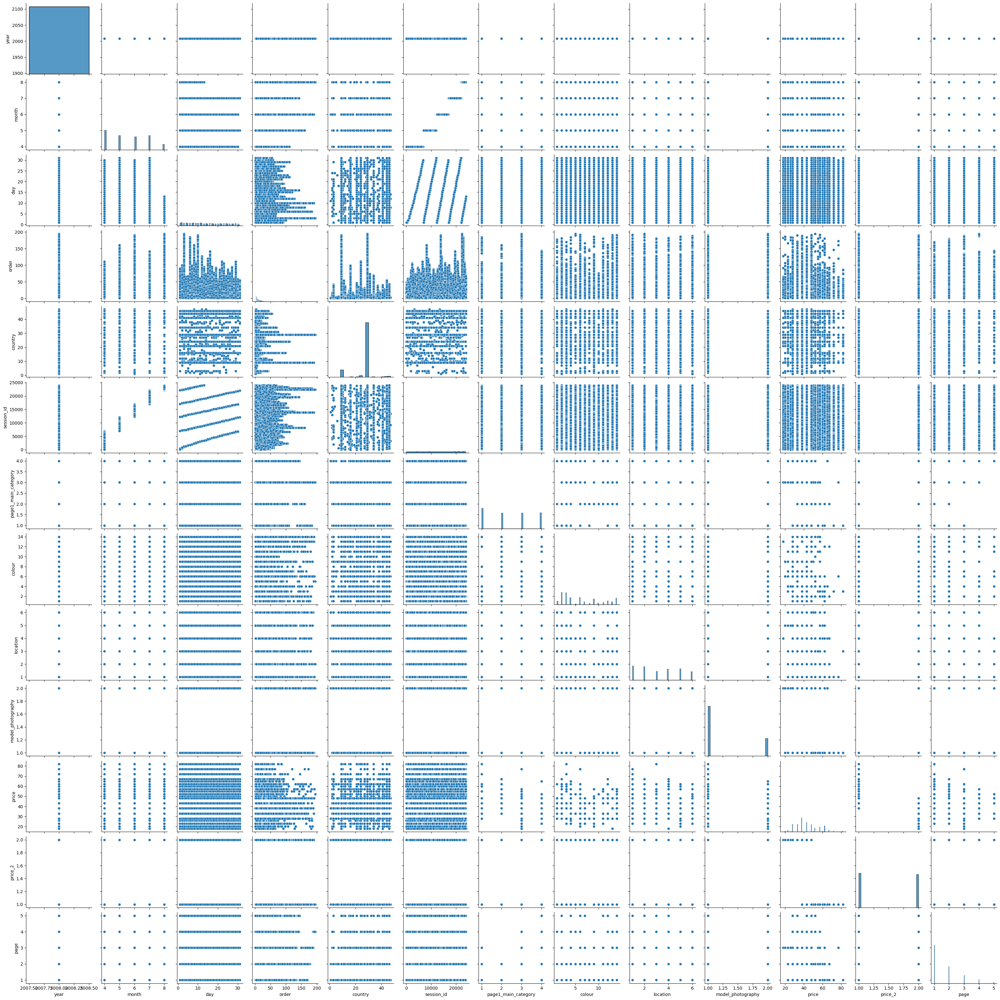

In [ ]:
sns.pairplot(data)

In [ ]:
# Find the inertia value
in_va = []
for i in range(1,21):
  kmodel = KMeans(n_clusters=i,random_state=0,n_init=10)
  km = Pipeline([('preprocess',preprocess),('KMeans',kmodel)])
  km.fit(data)
  in_va.append(kmodel.inertia_)

In [ ]:
in_va

[150444.55317238343,
 113866.04166266075,
 95838.15081243686,
 86289.7420331091,
 79074.42486439414,
 71969.61286201989,
 67585.77817555665,
 64262.017594697114,
 61742.76773476489,
 59235.97782917382,
 56916.51425203095,
 55309.47142565046,
 53276.57178900018,
 51810.4865178584,
 50643.488443266506,
 49488.74243754464,
 47816.10735188541,
 47019.62165758054,
 45562.067707949565,
 44447.98219012593]

In [ ]:
px.line(x=range(1,21),y=in_va,title='Elbow method')

In [ ]:
scaler = MinMaxScaler()
data[num_col]=scaler.fit_transform(data[num_col])
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,0.50,0.700000,0.103093,0.608696,0.666667,88,0.923077,0.0,1.0,0.468750,0.0,0.25
1,0.25,0.600000,0.025773,0.608696,0.333333,60,0.923077,0.4,0.0,0.609375,0.0,0.25
2,0.75,0.466667,0.005155,0.608696,0.666667,80,0.615385,0.8,0.0,0.468750,0.0,0.00
3,0.25,0.033333,0.005155,0.608696,0.333333,45,0.076923,0.6,0.0,0.390625,1.0,0.00
4,0.50,0.266667,0.077320,0.608696,0.333333,66,0.615385,0.8,0.0,0.609375,0.0,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,0.75,0.100000,0.010309,0.608696,1.000000,145,0.076923,0.0,0.0,0.468750,0.0,0.25
132375,0.50,0.600000,0.041237,0.608696,0.666667,94,1.000000,0.4,0.0,0.156250,1.0,0.25
132376,0.75,0.466667,0.015464,0.608696,0.000000,33,0.153846,0.2,1.0,0.312500,1.0,0.00
132377,0.75,0.900000,0.077320,0.608696,0.666667,121,0.615385,0.8,1.0,0.031250,1.0,0.50


In [ ]:
sil_score=[]

for i in range(2,11):
  kmodel = KMeans(n_clusters=i,random_state=0,n_init=10)
  cluster_labels = kmodel.fit_predict(data)
  silhouette_avg = silhouette_score(data, cluster_labels)
  print("For n_clusters =", i,
        "The average silhouette_score is :", silhouette_avg)
  sil_score.append(silhouette_avg)

For n_clusters = 2 The average silhouette_score is : 0.6561199947812786
For n_clusters = 3 The average silhouette_score is : 0.5553584917625627
For n_clusters = 4 The average silhouette_score is : 0.5801899621932791
For n_clusters = 5 The average silhouette_score is : 0.597803347538187
For n_clusters = 6 The average silhouette_score is : 0.5796172574105246
For n_clusters = 7 The average silhouette_score is : 0.5832960554654817
For n_clusters = 8 The average silhouette_score is : 0.5589802677834158
For n_clusters = 9 The average silhouette_score is : 0.5749748194564933
For n_clusters = 10 The average silhouette_score is : 0.5744153453809742


In [ ]:
px.line(x=range(2,11),y=sil_score,title='Silhouette Score')

In [ ]:
k_values = range(2,11)
optimal_value = k_values[sil_score.index(max(sil_score))]
print("Optimal K-value :",optimal_value)

Optimal K-value : 2


In [ ]:
data['Predicted_cluster'] = KMeans(n_clusters=optimal_value,random_state=0,n_init=10).fit_predict(data)
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page,Predicted_cluster
0,0.50,0.700000,0.103093,0.608696,0.666667,88,0.923077,0.0,1.0,0.468750,0.0,0.25,1
1,0.25,0.600000,0.025773,0.608696,0.333333,60,0.923077,0.4,0.0,0.609375,0.0,0.25,1
2,0.75,0.466667,0.005155,0.608696,0.666667,80,0.615385,0.8,0.0,0.468750,0.0,0.00,1
3,0.25,0.033333,0.005155,0.608696,0.333333,45,0.076923,0.6,0.0,0.390625,1.0,0.00,1
4,0.50,0.266667,0.077320,0.608696,0.333333,66,0.615385,0.8,0.0,0.609375,0.0,0.25,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,0.75,0.100000,0.010309,0.608696,1.000000,145,0.076923,0.0,0.0,0.468750,0.0,0.25,0
132375,0.50,0.600000,0.041237,0.608696,0.666667,94,1.000000,0.4,0.0,0.156250,1.0,0.25,1
132376,0.75,0.466667,0.015464,0.608696,0.000000,33,0.153846,0.2,1.0,0.312500,1.0,0.00,1
132377,0.75,0.900000,0.077320,0.608696,0.666667,121,0.615385,0.8,1.0,0.031250,1.0,0.50,0


In [ ]:
px.scatter(data,x= 'price',y= 'page2_clothing_model',color='Predicted_cluster')

In [ ]:
px.scatter_3d(data,x= 'price',y= 'page2_clothing_model',z='price_2',color='Predicted_cluster')

In [ ]:
px.scatter_3d(data,x= 'price',y= 'country',z = 'page1_main_category',color='Predicted_cluster')

In [ ]:
k_bs_model = KMeans(n_clusters=optimal_value,random_state=0,n_init=10)

In [ ]:
filename = "/content/drive/MyDrive/Project4-Clickstream/Kmeans_bs_model.sav"
pickle.dump(k_bs_model, open(filename, 'wb'))

In [ ]:
db_score= []
for i in range(2,11):
  kmodel = KMeans(n_clusters=i,random_state=0,n_init=10)
  cluster_labels = kmodel.fit_predict(data)
  db_score.append(davies_bouldin_score(data, cluster_labels))
  print("For n_clusters =", i,
        "The average davies_bouldin_score is :", davies_bouldin_score(data, cluster_labels))

For n_clusters = 2 The average davies_bouldin_score is : 0.4718543580637969
For n_clusters = 3 The average davies_bouldin_score is : 0.5644065098492836
For n_clusters = 4 The average davies_bouldin_score is : 0.5127984889543398
For n_clusters = 5 The average davies_bouldin_score is : 0.47732108850391686
For n_clusters = 6 The average davies_bouldin_score is : 0.5014117519051783
For n_clusters = 7 The average davies_bouldin_score is : 0.4831183767160538
For n_clusters = 8 The average davies_bouldin_score is : 0.5290278182342685
For n_clusters = 9 The average davies_bouldin_score is : 0.5123214380473988
For n_clusters = 10 The average davies_bouldin_score is : 0.5056158386869382


In [ ]:
k_values = range(2,11)
optimal_value = k_values[db_score.index(min(db_score))]
print("Optimal K-value as per Davis-Bouldin score:",optimal_value)

Optimal K-value as per Davis-Bouldin score: 2


In [ ]:
px.line(data,x=range(2,11),y=db_score,title='Davies Bouldin Score for train data')

In [ ]:
test_data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/test_data.csv",delimiter=',')
test_data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,4,22,4,29,5279,4,P48,9,4,2,33,2,3
1,2008,5,19,1,29,10059,1,A15,14,5,2,33,2,1
2,2008,4,11,10,29,2919,4,P23,6,2,2,28,2,2
3,2008,4,28,3,27,6304,2,B24,11,2,1,57,1,2
4,2008,5,26,1,29,11266,1,A2,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,2008,5,13,1,29,8885,1,A5,3,2,1,43,2,1
33091,2008,4,14,3,29,3546,1,A15,14,5,2,33,2,1
33092,2008,6,13,37,29,14336,2,B9,1,3,1,48,2,1
33093,2008,5,23,16,29,10786,3,C34,7,6,1,48,1,2


In [ ]:
test_data.drop(columns=['year','session_id'],axis=1,inplace=True)
test_data['page2_clothing_model'] = le.fit_transform(test_data['page2_clothing_model'])
test_data [num_col] = scaler.transform(test_data[num_col])
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,0.00,0.700000,0.015464,0.608696,1.000000,176,0.615385,0.6,1.0,0.234375,1.0,0.50
1,0.25,0.600000,0.000000,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00
2,0.00,0.333333,0.046392,0.608696,1.000000,149,0.384615,0.2,1.0,0.156250,1.0,0.25
3,0.00,0.900000,0.010309,0.565217,0.333333,58,0.769231,0.2,0.0,0.609375,0.0,0.25
4,0.25,0.833333,0.000000,0.608696,0.000000,11,0.153846,0.0,0.0,0.390625,1.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...
33090,0.25,0.400000,0.000000,0.608696,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00
33091,0.00,0.433333,0.010309,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00
33092,0.50,0.400000,0.185567,0.608696,0.333333,75,0.000000,0.4,0.0,0.468750,1.0,0.00
33093,0.25,0.733333,0.077320,0.608696,0.666667,103,0.461538,1.0,0.0,0.468750,0.0,0.25


In [ ]:
test_data['Predicted_cluster'] = k_bs_model.fit_predict(test_data)
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page,Predicted_cluster
0,0.00,0.700000,0.015464,0.608696,1.000000,176,0.615385,0.6,1.0,0.234375,1.0,0.50,1
1,0.25,0.600000,0.000000,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00,0
2,0.00,0.333333,0.046392,0.608696,1.000000,149,0.384615,0.2,1.0,0.156250,1.0,0.25,1
3,0.00,0.900000,0.010309,0.565217,0.333333,58,0.769231,0.2,0.0,0.609375,0.0,0.25,0
4,0.25,0.833333,0.000000,0.608696,0.000000,11,0.153846,0.0,0.0,0.390625,1.0,0.00,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,0.25,0.400000,0.000000,0.608696,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00,0
33091,0.00,0.433333,0.010309,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00,0
33092,0.50,0.400000,0.185567,0.608696,0.333333,75,0.000000,0.4,0.0,0.468750,1.0,0.00,0
33093,0.25,0.733333,0.077320,0.608696,0.666667,103,0.461538,1.0,0.0,0.468750,0.0,0.25,1


In [ ]:
px.scatter(test_data,x= 'price',y= 'page2_clothing_model',color='Predicted_cluster')

In [ ]:
px.scatter_3d(test_data,x= 'price',y= 'page2_clothing_model',z='price_2',color='Predicted_cluster')

In [ ]:
px.scatter_3d(test_data,x= 'price',y= 'page1_main_category',z = 'price_2',color='Predicted_cluster')

**Hierarchial clustering**

In [ ]:
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,6,22,21,29,3,88,13,1,2,48,1,2
1,5,19,6,29,2,60,13,3,1,57,1,2
2,7,15,2,29,3,80,9,5,1,48,1,1
3,5,2,2,29,2,45,2,4,1,43,2,1
4,6,9,16,29,2,66,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,7,4,3,29,4,145,2,1,1,48,1,2
132375,6,19,9,29,3,94,14,3,1,28,2,2
132376,7,15,4,29,1,33,3,2,2,38,2,1
132377,7,28,16,29,3,121,9,5,2,20,2,3


In [ ]:
df = data.sample(10000)
df

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
35837,8,8,2,29,1,38,3,2,1,43,2,1
2017,6,26,5,29,4,189,2,2,1,43,1,1
69215,4,10,15,29,3,89,14,1,1,57,1,2
103036,5,16,11,9,3,133,2,3,2,48,1,1
55138,6,29,1,38,1,41,3,3,1,62,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
24513,7,23,5,29,4,155,5,4,2,33,2,2
124940,4,21,3,29,4,214,6,4,2,48,1,5
56098,5,27,4,29,1,1,3,4,1,38,2,1
60541,7,18,4,29,1,22,3,1,1,72,1,1


In [ ]:
scaler = MinMaxScaler()
df[num_col]=scaler.fit_transform(df[num_col])
df

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
35837,1.00,0.233333,0.005464,0.622222,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00
2017,0.50,0.833333,0.021858,0.622222,1.000000,189,0.076923,0.2,0.0,0.390625,0.0,0.00
69215,0.00,0.300000,0.076503,0.622222,0.666667,89,1.000000,0.0,0.0,0.609375,0.0,0.25
103036,0.25,0.500000,0.054645,0.177778,0.666667,133,0.076923,0.4,1.0,0.468750,0.0,0.00
55138,0.50,0.933333,0.000000,0.822222,0.000000,41,0.153846,0.4,0.0,0.687500,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...
24513,0.75,0.733333,0.021858,0.622222,1.000000,155,0.307692,0.6,1.0,0.234375,1.0,0.25
124940,0.00,0.666667,0.010929,0.622222,1.000000,214,0.384615,0.6,1.0,0.468750,0.0,1.00
56098,0.25,0.866667,0.016393,0.622222,0.000000,1,0.153846,0.6,0.0,0.312500,1.0,0.00
60541,0.75,0.566667,0.016393,0.622222,0.000000,22,0.153846,0.0,0.0,0.843750,0.0,0.00


In [ ]:
sil_score = []

for i in range(2,11):
  cluster_labels = AgglomerativeClustering(n_clusters=i).fit_predict(df)
  silhouette_avg = silhouette_score(df, cluster_labels)
  print("For n_clusters =", i,
        "The average silhouette_score is :", silhouette_avg)
  sil_score.append(silhouette_avg)

For n_clusters = 2 The average silhouette_score is : 0.629233778627893
For n_clusters = 3 The average silhouette_score is : 0.5553370389854765
For n_clusters = 4 The average silhouette_score is : 0.5595146327625234
For n_clusters = 5 The average silhouette_score is : 0.533230829829421
For n_clusters = 6 The average silhouette_score is : 0.5405546678266138
For n_clusters = 7 The average silhouette_score is : 0.5468919843622255
For n_clusters = 8 The average silhouette_score is : 0.5357187592424959
For n_clusters = 9 The average silhouette_score is : 0.5378302446826728
For n_clusters = 10 The average silhouette_score is : 0.5390761033566903


In [ ]:
k_values = range(2,11)
optimal_k = k_values[sil_score.index(max(sil_score))]
print("Optimal K-value :",optimal_k)

Optimal K-value : 2


In [ ]:
px.line(x=range(2,11),y=sil_score,title='Silhouette Score for 10000 samples using AgglomerativeClustering')

In [ ]:
db_score = []
for i in range(2,11):
  cluster_labels = AgglomerativeClustering(n_clusters=i).fit_predict(df)
  db_score.append(davies_bouldin_score(df, cluster_labels))
  print("For n_clusters =", i,
        "The average davies_bouldin_score is :", davies_bouldin_score(df, cluster_labels))

For n_clusters = 2 The average davies_bouldin_score is : 0.4752443417108316
For n_clusters = 3 The average davies_bouldin_score is : 0.5532046632729796
For n_clusters = 4 The average davies_bouldin_score is : 0.5110113217265363
For n_clusters = 5 The average davies_bouldin_score is : 0.47971112481596573
For n_clusters = 6 The average davies_bouldin_score is : 0.4786848025570835
For n_clusters = 7 The average davies_bouldin_score is : 0.4892465335062229
For n_clusters = 8 The average davies_bouldin_score is : 0.48216013299759
For n_clusters = 9 The average davies_bouldin_score is : 0.4829024615713535
For n_clusters = 10 The average davies_bouldin_score is : 0.47910346829582007


In [ ]:
optimal_k = k_values[db_score.index(min(db_score))]
print("Optimal K-value as per Davis-Bouldin score:",optimal_k)

Optimal K-value as per Davis-Bouldin score: 2


In [ ]:
px.line(x=range(2,11),y=db_score,title='Davies Bouldin Score for 10000 samples using AgglomerativeClustering')

In [ ]:
z = linkage(df,method='ward')

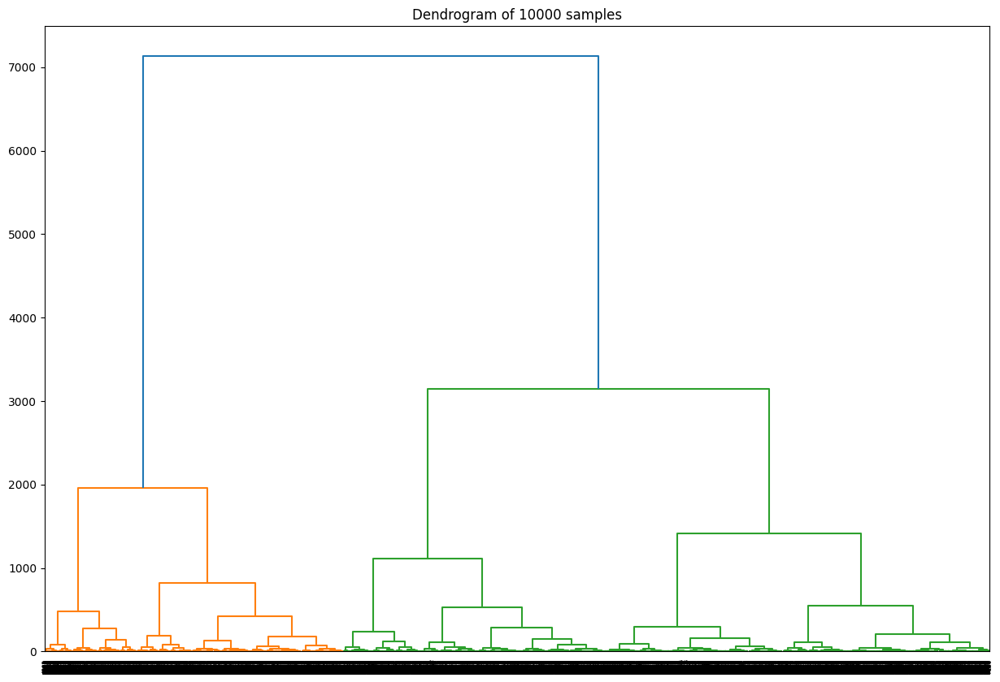

In [ ]:
plt.figure(figsize=(15,10))
plt.title("Dendrogram of 10000 samples")
dendrogram(z)
plt.show()

In [ ]:
test_data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/test_data.csv",delimiter=',')
test_data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,4,22,4,29,5279,4,P48,9,4,2,33,2,3
1,2008,5,19,1,29,10059,1,A15,14,5,2,33,2,1
2,2008,4,11,10,29,2919,4,P23,6,2,2,28,2,2
3,2008,4,28,3,27,6304,2,B24,11,2,1,57,1,2
4,2008,5,26,1,29,11266,1,A2,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,2008,5,13,1,29,8885,1,A5,3,2,1,43,2,1
33091,2008,4,14,3,29,3546,1,A15,14,5,2,33,2,1
33092,2008,6,13,37,29,14336,2,B9,1,3,1,48,2,1
33093,2008,5,23,16,29,10786,3,C34,7,6,1,48,1,2


In [ ]:
test_data.drop(columns=['year','session_id'],axis=1,inplace=True)
test_data['page2_clothing_model'] = le.fit_transform(test_data['page2_clothing_model'])
test_data [num_col] = scaler.transform(test_data[num_col])
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,0.00,0.700000,0.016393,0.622222,1.000000,176,0.615385,0.6,1.0,0.234375,1.0,0.50
1,0.25,0.600000,0.000000,0.622222,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00
2,0.00,0.333333,0.049180,0.622222,1.000000,149,0.384615,0.2,1.0,0.156250,1.0,0.25
3,0.00,0.900000,0.010929,0.577778,0.333333,58,0.769231,0.2,0.0,0.609375,0.0,0.25
4,0.25,0.833333,0.000000,0.622222,0.000000,11,0.153846,0.0,0.0,0.390625,1.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...
33090,0.25,0.400000,0.000000,0.622222,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00
33091,0.00,0.433333,0.010929,0.622222,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00
33092,0.50,0.400000,0.196721,0.622222,0.333333,75,0.000000,0.4,0.0,0.468750,1.0,0.00
33093,0.25,0.733333,0.081967,0.622222,0.666667,103,0.461538,1.0,0.0,0.468750,0.0,0.25


In [ ]:
agg_bs_model = AgglomerativeClustering(n_clusters=optimal_k)

In [ ]:
cluster_label = agg_bs_model.fit_predict(test_data)
print("silhouette score for test data: ",silhouette_score(test_data, cluster_label))
print("davies_bouldin_score for test data: ",davies_bouldin_score(test_data, cluster_label))

silhouette score for test data:  0.6036200344671212
davies_bouldin_score for test data:  0.516088967284261


In [ ]:
test_data['Predicted_cluster'] = agg_bs_model.fit_predict(test_data)
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page,Predicted_cluster
0,0.00,0.700000,0.016393,0.622222,1.000000,176,0.615385,0.6,1.0,0.234375,1.0,0.50,0
1,0.25,0.600000,0.000000,0.622222,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00,1
2,0.00,0.333333,0.049180,0.622222,1.000000,149,0.384615,0.2,1.0,0.156250,1.0,0.25,0
3,0.00,0.900000,0.010929,0.577778,0.333333,58,0.769231,0.2,0.0,0.609375,0.0,0.25,1
4,0.25,0.833333,0.000000,0.622222,0.000000,11,0.153846,0.0,0.0,0.390625,1.0,0.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,0.25,0.400000,0.000000,0.622222,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00,1
33091,0.00,0.433333,0.010929,0.622222,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00,1
33092,0.50,0.400000,0.196721,0.622222,0.333333,75,0.000000,0.4,0.0,0.468750,1.0,0.00,0
33093,0.25,0.733333,0.081967,0.622222,0.666667,103,0.461538,1.0,0.0,0.468750,0.0,0.25,0


In [ ]:
px.scatter_3d(test_data,x= 'price',y= 'page1_main_category',z='price_2',color='Predicted_cluster')

In [ ]:
px.scatter_3d(test_data,x= 'price',y= 'page2_clothing_model',z='price_2',color='Predicted_cluster')

**Density Based clustering**

In [ ]:
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,6,22,21,29,3,88,13,1,2,48,1,2
1,5,19,6,29,2,60,13,3,1,57,1,2
2,7,15,2,29,3,80,9,5,1,48,1,1
3,5,2,2,29,2,45,2,4,1,43,2,1
4,6,9,16,29,2,66,9,5,1,57,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,7,4,3,29,4,145,2,1,1,48,1,2
132375,6,19,9,29,3,94,14,3,1,28,2,2
132376,7,15,4,29,1,33,3,2,2,38,2,1
132377,7,28,16,29,3,121,9,5,2,20,2,3


In [ ]:
scaler = MinMaxScaler()
data[num_col]=scaler.fit_transform(data[num_col])
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,0.50,0.700000,0.103093,0.608696,0.666667,88,0.923077,0.0,1.0,0.468750,0.0,0.25
1,0.25,0.600000,0.025773,0.608696,0.333333,60,0.923077,0.4,0.0,0.609375,0.0,0.25
2,0.75,0.466667,0.005155,0.608696,0.666667,80,0.615385,0.8,0.0,0.468750,0.0,0.00
3,0.25,0.033333,0.005155,0.608696,0.333333,45,0.076923,0.6,0.0,0.390625,1.0,0.00
4,0.50,0.266667,0.077320,0.608696,0.333333,66,0.615385,0.8,0.0,0.609375,0.0,0.25
...,...,...,...,...,...,...,...,...,...,...,...,...
132374,0.75,0.100000,0.010309,0.608696,1.000000,145,0.076923,0.0,0.0,0.468750,0.0,0.25
132375,0.50,0.600000,0.041237,0.608696,0.666667,94,1.000000,0.4,0.0,0.156250,1.0,0.25
132376,0.75,0.466667,0.015464,0.608696,0.000000,33,0.153846,0.2,1.0,0.312500,1.0,0.00
132377,0.75,0.900000,0.077320,0.608696,0.666667,121,0.615385,0.8,1.0,0.031250,1.0,0.50


In [ ]:
db_scan = DBSCAN(eps=0.5,min_samples=10)
clusters = db_scan.fit_predict(data)
data['Predicted_cluster'] = clusters
data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page,Predicted_cluster
0,0.50,0.700000,0.103093,0.608696,0.666667,88,0.923077,0.0,1.0,0.468750,0.0,0.25,0
1,0.25,0.600000,0.025773,0.608696,0.333333,60,0.923077,0.4,0.0,0.609375,0.0,0.25,1
2,0.75,0.466667,0.005155,0.608696,0.666667,80,0.615385,0.8,0.0,0.468750,0.0,0.00,2
3,0.25,0.033333,0.005155,0.608696,0.333333,45,0.076923,0.6,0.0,0.390625,1.0,0.00,3
4,0.50,0.266667,0.077320,0.608696,0.333333,66,0.615385,0.8,0.0,0.609375,0.0,0.25,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
132374,0.75,0.100000,0.010309,0.608696,1.000000,145,0.076923,0.0,0.0,0.468750,0.0,0.25,152
132375,0.50,0.600000,0.041237,0.608696,0.666667,94,1.000000,0.4,0.0,0.156250,1.0,0.25,17
132376,0.75,0.466667,0.015464,0.608696,0.000000,33,0.153846,0.2,1.0,0.312500,1.0,0.00,86
132377,0.75,0.900000,0.077320,0.608696,0.666667,121,0.615385,0.8,1.0,0.031250,1.0,0.50,124


In [ ]:
px.scatter_3d(data,x= 'price',y= 'page1_main_category',z='price_2',color='Predicted_cluster')

In [ ]:
px.scatter_3d(data,x= 'price',y= 'page2_clothing_model',z='price_2',color='Predicted_cluster')

In [ ]:
print("silhouette score for train data: ",silhouette_score(data, clusters))
print("davies_bouldin_score for train data: ",davies_bouldin_score(data, clusters))

silhouette score for train data:  0.8924283585229319
davies_bouldin_score for train data:  0.5665471778283561


In [ ]:
# Count occurrences of -1 in the NumPy array 'clusters'
outlier_count = np.count_nonzero(clusters == -1)

# Print the count of outliers
print("Number of outliers: ", outlier_count)

Number of outliers:  136


In [ ]:
data[data['Predicted_cluster']==]

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page,Predicted_cluster
1083,1.00,0.066667,0.788660,0.608696,0.666667,89,1.000000,0.0,0.0,0.609375,0.0,0.25,-1
2447,1.00,0.066667,0.680412,0.608696,0.333333,66,0.615385,0.8,0.0,0.609375,0.0,0.25,-1
2653,0.50,0.300000,0.685567,0.173913,0.666667,86,0.846154,0.0,0.0,0.468750,0.0,0.25,-1
4905,1.00,0.066667,0.896907,0.608696,0.666667,110,1.000000,0.2,1.0,0.156250,1.0,0.50,-1
6228,1.00,0.066667,0.917526,0.608696,0.666667,114,1.000000,0.4,0.0,0.578125,0.0,0.50,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
129602,0.50,0.300000,0.912371,0.173913,0.666667,121,0.615385,0.8,1.0,0.031250,1.0,0.50,-1
129851,1.00,0.066667,0.876289,0.608696,0.666667,106,0.076923,0.0,0.0,0.390625,0.0,0.50,-1
129899,0.50,0.300000,0.953608,0.173913,0.666667,122,0.384615,0.8,0.0,0.031250,1.0,0.50,-1
130024,1.00,0.066667,0.809278,0.608696,0.666667,91,0.153846,0.2,0.0,0.390625,0.0,0.25,-1


In [ ]:
clusters.max()

np.int64(212)

In [ ]:
filename = "/content/drive/MyDrive/Project4-Clickstream/DB_scan_bs_model.sav"
pickle.dump(db_scan, open(filename, 'wb'))

In [ ]:
test_data = pd.read_csv("/content/drive/MyDrive/Project4-Clickstream/test_data.csv",delimiter=',')
test_data

,year,month,day,order,country,session_id,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,2008,4,22,4,29,5279,4,P48,9,4,2,33,2,3
1,2008,5,19,1,29,10059,1,A15,14,5,2,33,2,1
2,2008,4,11,10,29,2919,4,P23,6,2,2,28,2,2
3,2008,4,28,3,27,6304,2,B24,11,2,1,57,1,2
4,2008,5,26,1,29,11266,1,A2,3,1,1,43,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,2008,5,13,1,29,8885,1,A5,3,2,1,43,2,1
33091,2008,4,14,3,29,3546,1,A15,14,5,2,33,2,1
33092,2008,6,13,37,29,14336,2,B9,1,3,1,48,2,1
33093,2008,5,23,16,29,10786,3,C34,7,6,1,48,1,2


In [ ]:
test_data.drop(columns=['year','session_id'],axis=1,inplace=True)
test_data['page2_clothing_model'] = le.fit_transform(test_data['page2_clothing_model'])
test_data [num_col] = scaler.transform(test_data[num_col])
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page
0,0.00,0.700000,0.015464,0.608696,1.000000,176,0.615385,0.6,1.0,0.234375,1.0,0.50
1,0.25,0.600000,0.000000,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00
2,0.00,0.333333,0.046392,0.608696,1.000000,149,0.384615,0.2,1.0,0.156250,1.0,0.25
3,0.00,0.900000,0.010309,0.565217,0.333333,58,0.769231,0.2,0.0,0.609375,0.0,0.25
4,0.25,0.833333,0.000000,0.608696,0.000000,11,0.153846,0.0,0.0,0.390625,1.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...
33090,0.25,0.400000,0.000000,0.608696,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00
33091,0.00,0.433333,0.010309,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00
33092,0.50,0.400000,0.185567,0.608696,0.333333,75,0.000000,0.4,0.0,0.468750,1.0,0.00
33093,0.25,0.733333,0.077320,0.608696,0.666667,103,0.461538,1.0,0.0,0.468750,0.0,0.25


In [ ]:
clusters = db_scan.fit_predict(test_data)
test_data['Predicted_cluster'] = clusters
test_data

,month,day,order,country,page1_main_category,page2_clothing_model,colour,location,model_photography,price,price_2,page,Predicted_cluster
0,0.00,0.700000,0.015464,0.608696,1.000000,176,0.615385,0.6,1.0,0.234375,1.0,0.50,0
1,0.25,0.600000,0.000000,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00,1
2,0.00,0.333333,0.046392,0.608696,1.000000,149,0.384615,0.2,1.0,0.156250,1.0,0.25,2
3,0.00,0.900000,0.010309,0.565217,0.333333,58,0.769231,0.2,0.0,0.609375,0.0,0.25,3
4,0.25,0.833333,0.000000,0.608696,0.000000,11,0.153846,0.0,0.0,0.390625,1.0,0.00,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
33090,0.25,0.400000,0.000000,0.608696,0.000000,38,0.153846,0.2,0.0,0.390625,1.0,0.00,29
33091,0.00,0.433333,0.010309,0.608696,0.000000,6,1.000000,0.8,1.0,0.234375,1.0,0.00,1
33092,0.50,0.400000,0.185567,0.608696,0.333333,75,0.000000,0.4,0.0,0.468750,1.0,0.00,82
33093,0.25,0.733333,0.077320,0.608696,0.666667,103,0.461538,1.0,0.0,0.468750,0.0,0.25,55


In [ ]:
print("silhouette score for test data: ",silhouette_score(test_data, clusters))
print("davies_bouldin_score for test data: ",davies_bouldin_score(test_data, clusters))

silhouette score for test data:  0.8932718574372674
davies_bouldin_score for test data:  0.5385181636723516


In [ ]:
clusters.max()

np.int64(213)

In [ ]:
# Count occurrences of -1 in the NumPy array 'clusters'
outlier_count = np.count_nonzero(clusters == -1)

# Print the count of outliers
print("Number of outliers: ", outlier_count)

Number of outliers:  119
